In [2]:
# Permite a interação com os gráficos usando o mouse
%matplotlib widget

In [3]:
# Parâmetros de Lorenz
sigma = 10.0
rho = 28.0
beta = 8.0 / 3.0

# Condições iniciais para os pontos
x1, y1, z1 = 1.0, 1.0, 1.0
x2, y2, z2 = 1.01, 1.0, 1.0 

# Tamanho do passo. Quanto menor for o valor mais suave a curva fica
dt = 0.001

n = 19270

pontos1 = []
pontos2 = []

# Calcula os pontos das trajetórias
for i in range(n):
    # Calcula as variáveis para os pontos
    dx1 = sigma * (y1 - x1) * dt
    dy1 = (x1 * (rho - z1) - y1) * dt
    dz1 = (x1 * y1 - beta * z1) * dt
    dx2 = sigma * (y2 - x2) * dt
    dy2 = (x2 * (rho - z2) - y2) * dt
    dz2 = (x2 * y2 - beta * z2) * dt

    # Atualiza as coordenadas dos pontos
    x1 += dx1
    y1 += dy1
    z1 += dz1
    x2 += dx2
    y2 += dy2
    z2 += dz2

    # Adiciona os pontos às listas
    pontos1.append((x1, y1, z1))
    pontos2.append((x2, y2, z2))

# Cria os gráficos
grafico1 = line3d(pontos1, color='blue', thickness=1)
grafico2 = line3d(pontos2, color='red', thickness=1)
ponto_azul = point3d((1, 1, 1), size=200, color='blue', marker='o')
ponto_ver = point3d((1.01, 1, 1), size=200, color='red', marker='o')

ponto_final_azul = point3d(pontos1[-1], size=200, color='blue', marker='x')
ponto_final_ver = point3d(pontos2[-1], size=200, color='red', marker='x')

(grafico1 + grafico2 + ponto_azul + ponto_ver + ponto_final_azul + ponto_final_ver).show()

(grafico1 + grafico2).show(frame=False)

Graphics3d Object

Graphics3d Object

/usr/lib/python3.12/site-packages/traitlets/traitlets.py:1385: DeprecationWarning: Passing unrecognized arguments to super(Toolbar).__init__().
NavigationToolbar2WebAgg.__init__() missing 1 required positional argument: 'canvas'
This is deprecated in traitlets 4.2.This error will be raised in a future release of traitlets.
  warn(


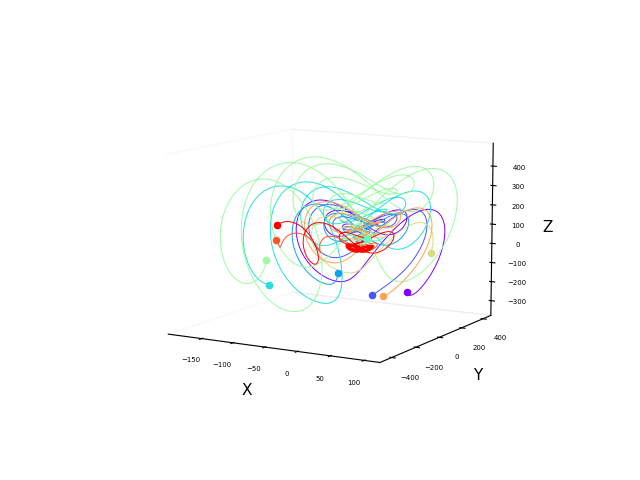

In [4]:
import matplotlib.pyplot as plt
import numpy as np
import random

sigma = 10.0
rho = 28.0
beta = 8.0 / 3.0

dt = 0.001

n = 19270

n_points = 10

# Função para calcular a próxima posição no atrator
def lorenz(x, y, z, dt, sigma, rho, beta):
    dx = sigma * (y - x) * dt
    dy = (x * (rho - z) - y) * dt
    dz = (x * y - beta * z) * dt
    x += dx
    y += dy
    z += dz
    return x, y, z

# Condições iniciais aleatórias para n pontos
initial_conditions = [(random.uniform(-200, 200), random.uniform(-200, 200), random.uniform(-200, 200)) for _ in range(n_points)]

trajetorias = []

# Calcula os pontos das trajetórias para cada ponto inicial
for ic in initial_conditions:
    x, y, z = ic
    traj = []
    for i in range(n):
        x, y, z = lorenz(x, y, z, dt, sigma, rho, beta)
        traj.append((x, y, z))
    trajetorias.append(traj)

# Cria a figura
fig = plt.figure()
fig.patch.set_facecolor('none')
ax = fig.add_subplot(111, projection='3d')
ax.grid(False)
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

# Plota as trajetórias de cada ponto com cores diferentes
colormap = plt.get_cmap("rainbow")
colors = [colormap(i) for i in np.linspace(0, 1, n_points)]
for i, traj in enumerate(trajetorias):
    x, y, z = zip(*traj)
    ax.plot(x, y, z, color=colors[i], linewidth=0.7)
    ax.scatter(x[0], y[0], z[0], c=[colors[i]], marker='o')


# Configurações do gráfico
ax.set_xlabel('X', fontsize=11)
ax.set_ylabel('Y', fontsize=11)
ax.set_zlabel('Z', fontsize=11)
ax.tick_params(axis='both', which='major', labelsize=5)
ax.view_init(elev=10)

# Salva em PDF
# plt.savefig("gráficos/atrator_lorenz_pontos_aleatorios.pdf", bbox_inches='tight')

plt.show()

In [1]:
# Executar no sagemath

import random

sigma = 10.0
rho = 28.0
beta = 8.0 / 3.0

dt = 0.0005

n = 20000

# Número de pontos iniciais
n_points = 15

# Função para calcular a próxima posição no atrator de Lorenz
def lorenz(x, y, z, dt, sigma, rho, beta):
    dx = sigma * (y - x) * dt
    dy = (x * (rho - z) - y) * dt
    dz = (x * y - beta * z) * dt
    x += dx
    y += dy
    z += dz
    return x, y, z

# Condições iniciais aleatórias para n pontos
condicoes_iniciais = [(random.uniform(-300, 300), random.uniform(-300, 300), random.uniform(-300, 300)) for _ in range(n_points)]

# Listas para armazenar as trajetórias de cada ponto
trajectories = []

# Calcula os pontos das trajetórias para cada ponto inicial
for ic in condicoes_iniciais:
    x, y, z = ic
    traj = []
    for i in range(n):
        x, y, z = lorenz(x, y, z, dt, sigma, rho, beta)
        traj.append((x, y, z))
    trajectories.append(traj)

# Configurações de cores
colormap = colormaps.rainbow
colors = [colormap(i / float(n_points)) for i in range(n_points)]

# Criação da figura 3D no SageMath
plot3d = sum(line3d(traj, color=colors[i], thickness=0.7) for i, traj in enumerate(trajectories))

# Exibe o gráfico
plot3d.show(aspect_ratio=1, frame=False)


Graphics3d Object

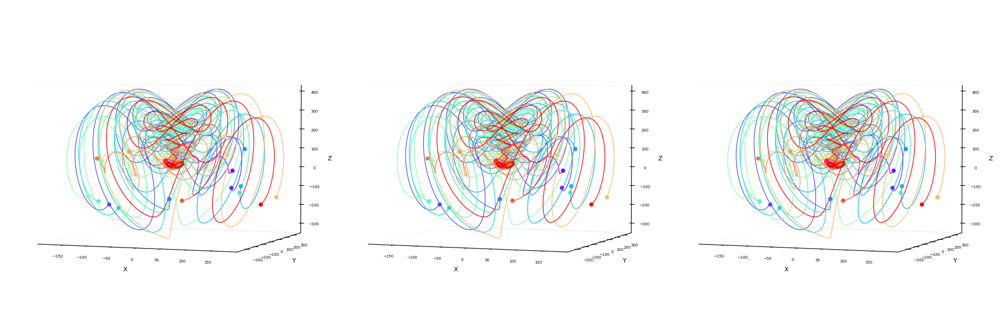

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import random


sigma = 10.0
rho = 28.0
beta = 8.0 / 3.0

dt = 0.001
n = 10000

n_pontos = 20

def lorenz(x, y, z, dt, sigma, rho, beta):
    dx = sigma * (y - x) * dt
    dy = (x * (rho - z) - y) * dt
    dz = (x * y - beta * z) * dt
    x += dx
    y += dy
    z += dz
    return x, y, z

# condições iniciais aleatórias em um determinado intervalo
condicoes_iniciais = [(random.uniform(-200, 200), random.uniform(-200, 200), random.uniform(-200, 200)) for _ in range(n_pontos)]

# Listas para armazenar as trajetórias de cada ponto
trajetoria = []

# Calcula os pontos das trajetórias para cada ponto inicial
for ic in condicoes_iniciais:
    x, y, z = ic
    traj = []
    for i in range(n):
        x, y, z = lorenz(x, y, z, dt, sigma, rho, beta)
        traj.append((x, y, z))
    trajetoria.append(traj)

all_x = np.array([p[0] for traj in trajetoria for p in traj])
all_y = np.array([p[1] for traj in trajetoria for p in traj])
all_z = np.array([p[2] for traj in trajetoria for p in traj])

x_min, x_max = all_x.min(), all_x.max()
y_min, y_max = all_y.min(), all_y.max()
z_min, z_max = all_z.min(), all_z.max()

fig = plt.figure(figsize=(18, 6))

# Subplots
ax1 = fig.add_subplot(131, projection='3d')
ax2 = fig.add_subplot(132, projection='3d')
ax3 = fig.add_subplot(133, projection='3d')

# espaçamentos entre os subplots
plt.subplots_adjust(left=0.05, right=0.1, top=0.1, bottom=0.05, wspace=0.01)

# Função para plotar trajetórias
def plot_trajectories(ax, trajetoria, colors):
    for i, traj in enumerate(trajetoria):
        x, y, z = zip(*traj)
        ax.plot(x, y, z, color=colors[i], linewidth=0.9)
        ax.scatter(x[0], y[0], z[0], c=[colors[i]], marker='o')

# Plota as trajetórias de cada ponto com cores diferentes
colormap = plt.get_cmap("rainbow")
colors = [colormap(i) for i in np.linspace(0, 1, n_pontos)]

# gráfico 1
plot_trajectories(ax1, trajetoria, colors)
ax1.set_xlim([x_min, x_max])
ax1.set_ylim([y_min, y_max])
ax1.set_zlim([z_min, z_max])
ax1.set_xlabel('X', fontsize=8)
ax1.set_ylabel('Y', fontsize=8)
ax1.set_zlabel('Z', fontsize=8)
ax1.tick_params(axis='both', which='major', labelsize=5)
ax1.xaxis.pane.fill = False
ax1.yaxis.pane.fill = False
ax1.zaxis.pane.fill = False
ax1.grid(False)
ax1.view_init(elev=3, azim=-69)

# gráfico 2
plot_trajectories(ax2, trajetoria, colors)
ax2.set_xlim([x_min, x_max])
ax2.set_ylim([y_min, y_max])
ax2.set_zlim([z_min, z_max])
ax2.set_xlabel('X', fontsize=8)
ax2.set_ylabel('Y', fontsize=8)
ax2.set_zlabel('Z', fontsize=8)
ax2.tick_params(axis='both', which='major', labelsize=5)
ax2.xaxis.pane.fill = False
ax2.yaxis.pane.fill = False
ax2.zaxis.pane.fill = False
ax2.grid(False)
ax2.view_init(elev=3, azim=-69)

# gráfico 3
plot_trajectories(ax3, trajetoria, colors)
ax3.set_xlim([x_min, x_max])
ax3.set_ylim([y_min, y_max])
ax3.set_zlim([z_min, z_max])
ax3.set_xlabel('X', fontsize=8)
ax3.set_ylabel('Y', fontsize=8)
ax3.set_zlabel('Z', fontsize=8)
ax3.tick_params(axis='both', which='major', labelsize=5)
ax3.xaxis.pane.fill = False
ax3.yaxis.pane.fill = False
ax3.zaxis.pane.fill = False
ax3.grid(False)
ax3.view_init(elev=3, azim=-69)

plt.tight_layout()

plt.show()


In [7]:
# salvar em pdf após ajustar com o mouse
plt.savefig("gráficos/atrator_lorenz_dois_subplots.pdf", bbox_inches='tight')

/usr/lib/python3.12/site-packages/traitlets/traitlets.py:1385: DeprecationWarning: Passing unrecognized arguments to super(Toolbar).__init__().
NavigationToolbar2WebAgg.__init__() missing 1 required positional argument: 'canvas'
This is deprecated in traitlets 4.2.This error will be raised in a future release of traitlets.
  warn(


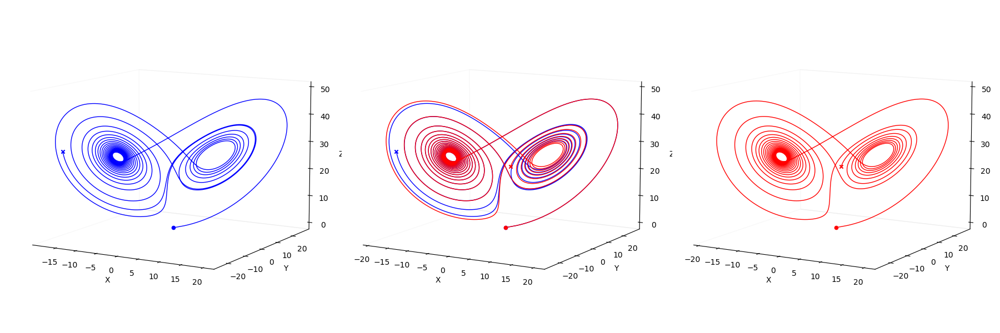

In [8]:
import matplotlib.pyplot as plt

sigma = 10.0
rho = 28.0
beta = 8.0 / 3.0

# Condições iniciai
x1, y1, z1 = 1.0, 1.0, 1.0
x2, y2, z2 = 1.01, 1.0, 1.0 
dt = 0.001
n = 19240
pontos1 = []
pontos2 = []

# Calcula os pontos das trajetórias
for i in range(n):
    dx1 = sigma * (y1 - x1) * dt
    dy1 = (x1 * (rho - z1) - y1) * dt
    dz1 = (x1 * y1 - beta * z1) * dt
    dx2 = sigma * (y2 - x2) * dt
    dy2 = (x2 * (rho - z2) - y2) * dt
    dz2 = (x2 * y2 - beta * z2) * dt
    x1 += dx1
    y1 += dy1
    z1 += dz1
    x2 += dx2
    y2 += dy2
    z2 += dz2
    pontos1.append((x1, y1, z1))
    pontos2.append((x2, y2, z2))

fig = plt.figure(figsize=(18, 6))
fig.patch.set_facecolor('none')

ax1 = fig.add_subplot(131, projection='3d')
ax1.plot(*zip(*pontos1), 'b-', linewidth=1, label='A')

ax1.scatter(1, 1, 1, c='b', marker='o')
ax1.scatter(pontos1[-1][0], pontos1[-1][1], pontos1[-1][2], c='b', marker='x')


ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')
ax1.grid(False)
ax1.xaxis.pane.fill = False
ax1.yaxis.pane.fill = False
ax1.zaxis.pane.fill = False
ax1.view_init(elev=10)


ax2 = fig.add_subplot(132, projection='3d')
ax2.plot(*zip(*pontos1), 'b-', linewidth=1, label='A')
ax2.plot(*zip(*pontos2), 'r-', linewidth=1, label='B')
ax2.scatter(1, 1, 1, c='b', marker='o')
ax2.scatter(pontos1[-1][0], pontos1[-1][1], pontos1[-1][2], c='b', marker='x')
ax2.scatter(1.01, 1, 1, c='r', marker='o')
ax2.scatter(pontos2[-1][0], pontos2[-1][1], pontos2[-1][2], c='r', marker='x')
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')
ax2.grid(False)
ax2.xaxis.pane.fill = False
ax2.yaxis.pane.fill = False
ax2.zaxis.pane.fill = False
ax2.view_init(elev=10)

ax3 = fig.add_subplot(133, projection='3d')
ax3.plot(*zip(*pontos2), 'r-', linewidth=1, label='B')
ax3.scatter(1.01, 1, 1, c='r', marker='o')
ax3.scatter(pontos2[-1][0], pontos2[-1][1], pontos2[-1][2], c='r', marker='x')
ax3.set_xlabel('X')
ax3.set_ylabel('Y')
ax3.set_zlabel('Z')
ax3.grid(False)
ax3.xaxis.pane.fill = False
ax3.yaxis.pane.fill = False
ax3.zaxis.pane.fill = False
ax3.view_init(elev=10)

plt.tight_layout()

# Salva em PDF
plt.savefig("gráficos/atrator_lorenz_tres_graficos.pdf", bbox_inches='tight')

# Mostra o gráfico
plt.show()
